In [23]:
import numpy as np
import pandas as pd 
from pathlib import Path
import os.path
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import tensorflow as tf
import random 
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")

In [4]:
print(tf.__version__)

2.17.1


In [5]:
def proc_img(filepath):
    labels = [str(filepath[i]).split('/')[-2] \
            for i in range(len(filepath))]
    filepath = pd.Series(filepath,name='Filepath').astype(str)
    labels=pd.Series(labels,name='Label')
    
    df=pd.concat([filepath,labels],axis=1)
    df=df.sample(frac=1).reset_index(drop=True)
    return df

def plot_model_trained(histort_model_trained):
    pd.DataFrame(histort_model_trained.history)[['loss','val_loss']].plot()
    plt.title("Loss")
    pd.DataFrame(histort_model_trained.history)[['accuracy','val_accuracy']].plot()
    plt.title("accracy")
    plt.show()
    
def evaluate_and_display(model, test_images, train_images, test_df, num_images=36, save_path=None):
    # Predict the label of the test images
    pred = model.predict(test_images)
    pred = np.argmax(pred, axis=1)
    
    # Map the labels
    labels = train_images.class_indices
    labels = {v: k for k, v in labels.items()}
    
    # Map predicted labels and true labels
    pred_labels = [labels[k] for k in pred]
    y_test = [labels[k] for k in test_images.classes]
    
    # Calculate accuracy
    acc = accuracy_score(y_test, pred_labels)
    print(f'Accuracy on the test set: {100*acc:.2f}%')

    # Randomly select 'num_images' indices from the test set
    num_images = min(num_images+1, len(test_df))  # Ensure we don't sample more than available
    random_indices = random.sample(range(len(test_df)), num_images)

    # Display some images with their true and predicted labels
    fig, axes = plt.subplots(nrows=6, ncols=6, figsize=(20, 20),
                             subplot_kw={'xticks': [], 'yticks': []})

    for i, ax in enumerate(axes.flat[:num_images]):
        idx = random_indices[i]  # Random index
        ax.imshow(plt.imread(test_df.Filepath.iloc[idx]))
        ax.set_title(f"True: {test_df.Label.iloc[idx]}\nPredicted: {pred_labels[idx]}")
    
    plt.tight_layout()
    if save_path:
        plt.savefig(save_path, bbox_inches='tight')
    plt.show()
    
def load_and_prep_image(filename,img_shape=224):
    img=tf.io.read_file(filename)
    img=tf.image.decode_image(img,channels=3)
    img=tf.image.resize(img,size=[img_shape,img_shape])
    #img=img/255. #remove it
    return img

def pred_and_plot(model, image, class_names):
    if isinstance(image, str):
        img = load_and_prep_image(image)
    else:
        img = tf.image.resize(image, [224, 224])  # Use 'image' instead of 'img' here
    pred = model.predict(tf.expand_dims(img, axis=0))
    pred_class = class_names[int(tf.round(pred)[0][0])]
    
    plt.imshow(img)  # Squeeze any extra dimensions for correct display
    plt.title(f"Prediction: {pred_class}")
    plt.axis(False)
    plt.show()


In [9]:
from pathlib import Path

# Define dataset paths
data_dirs = {
    "data_df": "/kaggle/input/700-8classes/Data",
    "data_df_1": "/kaggle/input/700-8classes/Data",
    "data_df_2": "/kaggle/input/next7classes/data",
    "data_df_3": "/kaggle/input/next7classes2/images",
    "data_df_4": "/kaggle/input/food-dataset",
    "data_df_5": "/kaggle/input/next7classes3/DATA",
    "data_df_6": "/kaggle/input/next4c/NEW",
}

# Function to process images
def get_image_paths(directory):
    path = Path(directory)
    return (
        list(path.glob(r'**/*.[jJ][pP][gG]')) +
        list(path.glob(r'**/*.[jJ][pP][eE][gG]')) +
        list(path.glob(r'**/*.[pP][nN][gG]'))
    )

# Dictionary to store processed DataFrames
data_dfs = {}

# Process each dataset
for name, dir_path in data_dirs.items():
    data_filepaths = get_image_paths(dir_path)
    data_dfs[name] = proc_img(data_filepaths)

# Display dataset stats
for name, df in data_dfs.items():
    print(f'-- {name} --\n')
    print(f'Number of pictures: {df.shape[0]}\n')
    print(f'Number of different labels: {len(df.Label.unique())}\n')
    print(f'Labels: {df.Label.unique()}\n')


-- data_df --

Number of pictures: 5600

Number of different labels: 8

Labels: ['Frise' 'Crispy Chicken' 'Pizza' 'Dount' 'Baked Potato' 'Hot Dog'
 'Burger' 'Taquito']

-- data_df_1 --

Number of pictures: 5600

Number of different labels: 8

Labels: ['Burger' 'Pizza' 'Hot Dog' 'Baked Potato' 'Frise' 'Crispy Chicken'
 'Taquito' 'Dount']

-- data_df_2 --

Number of pictures: 4913

Number of different labels: 7

Labels: ['bell pepper' 'cabbage' 'apple' 'cauliflower' 'banana' 'beetroot'
 'carrot']

-- data_df_3 --

Number of pictures: 4943

Number of different labels: 7

Labels: ['corn' 'cucumber' 'ginger' 'garlic' 'chilli pepper' 'eggplant' 'grapes']

-- data_df_4 --

Number of pictures: 5140

Number of different labels: 7

Labels: ['milk' 'yogurt' 'bread' 'eggs' 'crab' 'salamon' 'cheese']

-- data_df_5 --

Number of pictures: 4900

Number of different labels: 7

Labels: ['Lettuce' 'Onion' 'Jalapeno' 'Orange' 'Lemon' 'Mango' 'Kiwi']

-- data_df_6 --

Number of pictures: 2800

Number of d

In [13]:
data_dfs['data_df_6']

,Filepath,Label
0,/kaggle/input/next4c/NEW/Croissant/croissants0...,Croissant
1,/kaggle/input/next4c/NEW/Dragon Fruit/284_jpg....,Dragon Fruit
2,/kaggle/input/next4c/NEW/Chips/BAWYZB_jpeg.rf....,Chips
3,/kaggle/input/next4c/NEW/Dragon Fruit/126_jpg....,Dragon Fruit
4,/kaggle/input/next4c/NEW/Dragon Fruit/300_jpg....,Dragon Fruit
...,...,...
2795,/kaggle/input/next4c/NEW/Cake/download-96-_jpg...,Cake
2796,/kaggle/input/next4c/NEW/Dragon Fruit/61_jpg.r...,Dragon Fruit
2797,/kaggle/input/next4c/NEW/Chips/Barbecue24_JPG....,Chips
2798,/kaggle/input/next4c/NEW/Cake/images-101-_jpg....,Cake


In [14]:
data_df_First_group = pd.concat([data_dfs['data_df'], data_dfs['data_df_1'],data_dfs['data_df_2'],data_dfs['data_df_3']], ignore_index=True)
data_df_First_group = data_df_First_group.sample(frac=1).reset_index(drop=True)
len(data_df_First_group),data_df_First_group.shape, data_df_First_group.head(20)

(21056,
 (21056, 2),
                                              Filepath          Label
 0   /kaggle/input/700-8classes/Data/Baked Potato/B...   Baked Potato
 1   /kaggle/input/700-8classes/Data/Pizza/pizza_20...          Pizza
 2   /kaggle/input/700-8classes/Data/Baked Potato/B...   Baked Potato
 3   /kaggle/input/700-8classes/Data/Burger/images ...         Burger
 4   /kaggle/input/next7classes2/images/corn/images...           corn
 5   /kaggle/input/next7classes2/images/corn/images...           corn
 6   /kaggle/input/next7classes2/images/corn/downlo...           corn
 7   /kaggle/input/next7classes2/images/chilli pepp...  chilli pepper
 8   /kaggle/input/700-8classes/Data/Frise/2001959_...          Frise
 9   /kaggle/input/next7classes2/images/corn/images...           corn
 10  /kaggle/input/700-8classes/Data/Taquito/Taquit...        Taquito
 11  /kaggle/input/700-8classes/Data/Pizza/images (...          Pizza
 12  /kaggle/input/700-8classes/Data/Pizza/pizza_10...          Pizza

In [17]:
len(data_df_First_group.Label.unique())

22

In [15]:
data_df_Second_group = pd.concat([data_dfs['data_df_4'], data_dfs['data_df_5'],data_dfs['data_df_6']], ignore_index=True)
data_df_Second_group = data_df_Second_group.sample(frac=1).reset_index(drop=True)
len(data_df_Second_group),data_df_Second_group.shape, data_df_Second_group.head(20)

(12840,
 (12840, 2),
                                              Filepath     Label
 0   /kaggle/input/next7classes3/DATA/Onion/Onion (...     Onion
 1   /kaggle/input/next7classes3/DATA/Jalapeno/Jala...  Jalapeno
 2    /kaggle/input/food-dataset/yogurt/yogurt.979.jpg    yogurt
 3   /kaggle/input/next7classes3/DATA/Mango/Mango (...     Mango
 4   /kaggle/input/food-dataset/salamon/farmstrain-...   salamon
 5   /kaggle/input/next7classes3/DATA/Orange/Orange...    Orange
 6   /kaggle/input/food-dataset/crab/istockphoto-18...      crab
 7   /kaggle/input/next4c/NEW/Chips/BACJEP_jpeg.rf....     Chips
 8   /kaggle/input/next7classes3/DATA/Mango/Mango (...     Mango
 9   /kaggle/input/food-dataset/salamon/wildstrain-...   salamon
 10   /kaggle/input/food-dataset/cheese/cheese.351.jpg    cheese
 11  /kaggle/input/next4c/NEW/Cake/-77-_jpg.rf.f18e...      Cake
 12       /kaggle/input/food-dataset/milk/milk.367.jpg      milk
 13  /kaggle/input/next4c/NEW/Cake/-59-_jpg.rf.4d66...      Cake
 14 

In [18]:
len(data_df_Second_group.Label.unique())

18

In [16]:
len(data_df_First_group)+len(data_df_Second_group)

33896

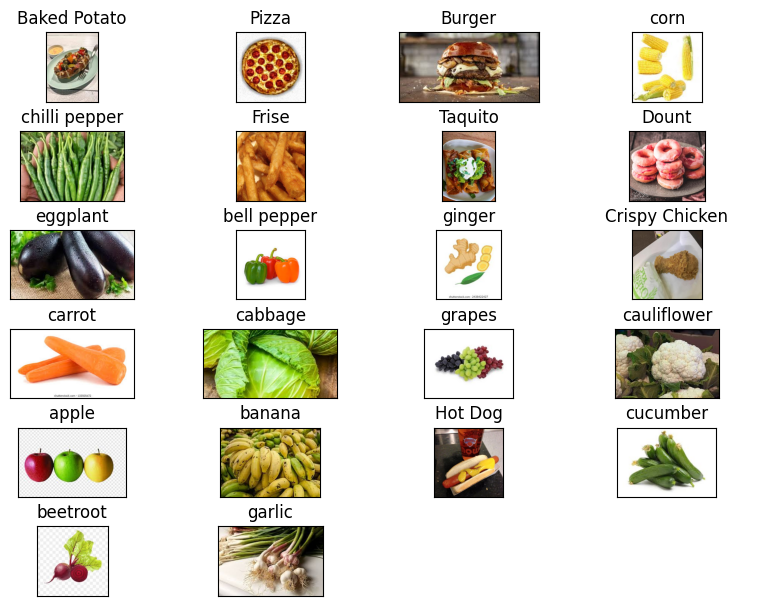

In [22]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'train_df' is your original DataFrame
df_unique = data_df_First_group.copy().drop_duplicates(subset=["Label"]).reset_index(drop=True)

# Check the number of unique labels
num_unique = len(df_unique)

# Display some pictures of the dataset
fig, axes = plt.subplots(nrows=6, ncols=4, figsize=(8,6 ),
                         subplot_kw={'xticks': [], 'yticks': []})

# Ensure we do not exceed the number of unique labels
for i, ax in enumerate(axes.flat):
    if i < num_unique:
        ax.imshow(plt.imread(df_unique.Filepath[i]))
        ax.set_title(df_unique.Label[i], fontsize=12)
    else:
        ax.axis('off')  # Hide any unused subplots

plt.tight_layout(pad=0.5)
plt.show()


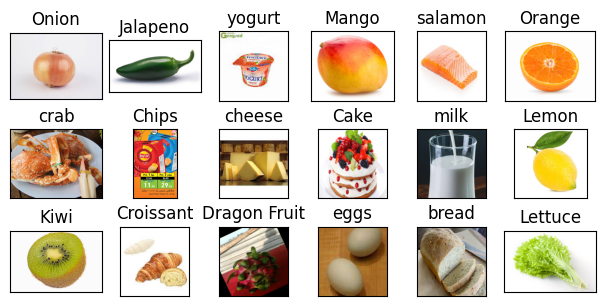

In [21]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'train_df' is your original DataFrame
df_unique = data_df_Second_group.copy().drop_duplicates(subset=["Label"]).reset_index(drop=True)

# Check the number of unique labels
num_unique = len(df_unique)

# Display some pictures of the dataset
fig, axes = plt.subplots(nrows=3, ncols=6, figsize=(6,3 ),
                         subplot_kw={'xticks': [], 'yticks': []})

# Ensure we do not exceed the number of unique labels
for i, ax in enumerate(axes.flat):
    if i < num_unique:
        ax.imshow(plt.imread(df_unique.Filepath[i]))
        ax.set_title(df_unique.Label[i], fontsize=12)
    else:
        ax.axis('off')  # Hide any unused subplots

plt.tight_layout(pad=0.5)
plt.show()


# *Training for data_df_First_group*

In [24]:
train_df, temp_df = train_test_split(data_df_First_group, test_size=0.3, random_state=42)  # 30% goes to temp

val_df, test_df = train_test_split(temp_df, test_size=0.5, random_state=42)  # 50% of 30% = 15% each

print("Training set:", train_df.shape)
print("Validation set:", val_df.shape)
print("Test set:", test_df.shape)

Training set: (14739, 2)
Validation set: (3158, 2)
Test set: (3159, 2)


In [25]:
train_generator = tf.keras.preprocessing.image.ImageDataGenerator(preprocessing_function=tf.keras.applications.efficientnet.preprocess_input)

test_generator = tf.keras.preprocessing.image.ImageDataGenerator(preprocessing_function=tf.keras.applications.efficientnet.preprocess_input)

In [26]:
train_images = train_generator.flow_from_dataframe(
    dataframe=train_df,
    x_col='Filepath',
    y_col='Label',
    target_size=(224, 224),
    color_mode='rgb',
    class_mode='categorical',
    batch_size=32,
    shuffle=True,
    seed=42,
    rotation_range=30,
    zoom_range=0.15,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode="nearest"
)

val_images = train_generator.flow_from_dataframe(
    dataframe=val_df,
    x_col='Filepath',
    y_col='Label',
    target_size=(224, 224),
    color_mode='rgb',
    class_mode='categorical',
    batch_size=32,
    shuffle=True,
    seed=42,
    rotation_range=30,
    zoom_range=0.15,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode="nearest"
)

test_images = test_generator.flow_from_dataframe(
    dataframe=test_df,
    x_col='Filepath',
    y_col='Label',
    target_size=(224, 224),
    color_mode='rgb',
    class_mode='categorical',
    batch_size=32,
    shuffle=False
)

Found 14739 validated image filenames belonging to 22 classes.
Found 3158 validated image filenames belonging to 22 classes.
Found 3159 validated image filenames belonging to 22 classes.


In [27]:
pretrained_model = tf.keras.applications.EfficientNetB0 (
    input_shape=(224, 224, 3),
    include_top=False,
    weights='imagenet',
    pooling='avg'
)
pretrained_model.trainable = False

16705208/16705208 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [28]:
inputs = pretrained_model.input

x = tf.keras.layers.Dense(256, activation='relu')(pretrained_model.output)
x = tf.keras.layers.Dense(128, activation='relu')(x)
x = tf.keras.layers.Dense(128, activation='relu')(x)


outputs = tf.keras.layers.Dense(len(train_images.class_indices), activation='softmax')(x)

model = tf.keras.Model(inputs=inputs, outputs=outputs)

model.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

initial_epoch=30

history = model.fit(
    train_images,
    validation_data=val_images,
    batch_size = 32,
    epochs=initial_epoch,
    callbacks=[
        tf.keras.callbacks.EarlyStopping(
            monitor='val_accuracy',
            patience=4,
            restore_best_weights=True
        ),
        tf.keras.callbacks.ModelCheckpoint(
        filepath = 'test1.keras',
        monitor = 'val_accuracy',
        save_best_only = True,
        mode = 'max',
        verbose = 1
        )
    ]
)

Epoch 1/30
460/461 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step - accuracy: 0.8144 - loss: 0.6768
Epoch 1: val_accuracy improved from -inf to 0.96612, saving model to test1.keras
461/461 ━━━━━━━━━━━━━━━━━━━━ 123s 217ms/step - accuracy: 0.8148 - loss: 0.6752 - val_accuracy: 0.9661 - val_loss: 0.1104
Epoch 2/30
460/461 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step - accuracy: 0.9757 - loss: 0.0743
Epoch 2: val_accuracy improved from 0.96612 to 0.97530, saving model to test1.keras
461/461 ━━━━━━━━━━━━━━━━━━━━ 50s 106ms/step - accuracy: 0.9757 - loss: 0.0743 - val_accuracy: 0.9753 - val_loss: 0.0889
Epoch 3/30
460/461 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - accuracy: 0.9846 - loss: 0.0469
Epoch 3: val_accuracy improved from 0.97530 to 0.98258, saving model to test1.keras
461/461 ━━━━━━━━━━━━━━━━━━━━ 48s 104ms/step - accuracy: 0.9846 - loss: 0.0469 - val_accuracy: 0.9826 - val_loss: 0.0607
Epoch 4/30
460/461 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step - accuracy: 0.9927 - loss: 0.0247
Epoch 4: val_accuracy did not improve fro

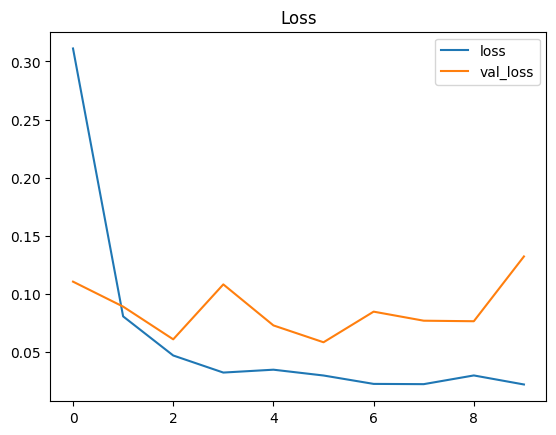

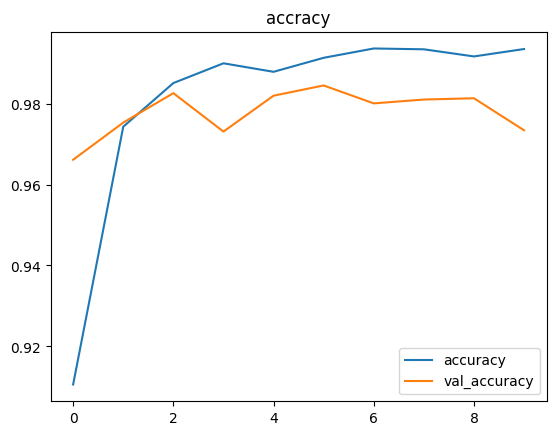

In [30]:
plot_model_trained(history)

99/99 ━━━━━━━━━━━━━━━━━━━━ 25s 200ms/step
Accuracy on the test set: 98.04%


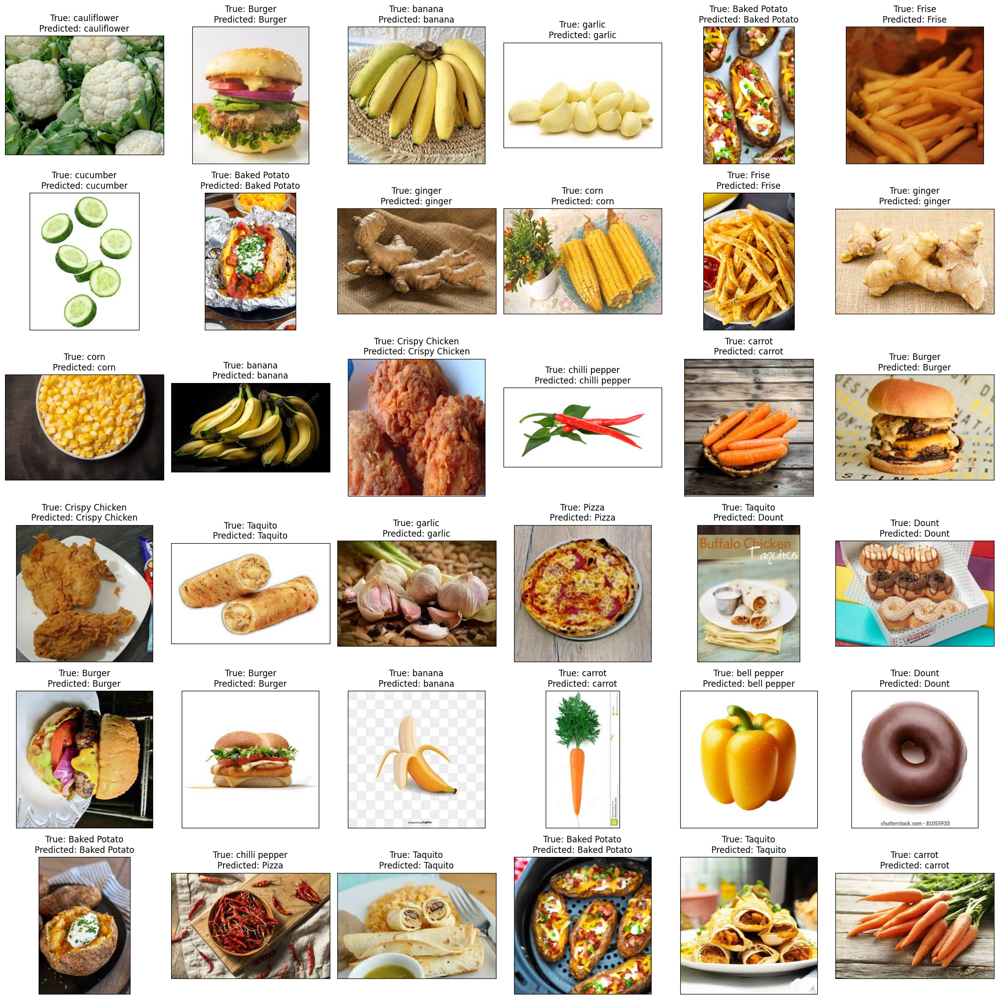

In [29]:
evaluate_and_display(model, test_images, train_images, test_df)

# Merge ALL one Time 

In [32]:
data_df = pd.concat([data_df_First_group,data_df_Second_group], ignore_index=True)
data_df = data_df.sample(frac=1).reset_index(drop=True)
len(data_df),data_df.shape, data_df.head(20)

(33896,
 (33896, 2),
                                              Filepath        Label
 0   /kaggle/input/700-8classes/Data/Pizza/pizza_31...        Pizza
 1   /kaggle/input/next7classes3/DATA/Lemon/Lemon (...        Lemon
 2   /kaggle/input/700-8classes/Data/Burger/images ...       Burger
 3   /kaggle/input/next7classes3/DATA/Jalapeno/Jala...     Jalapeno
 4   /kaggle/input/next7classes/data/bell pepper/im...  bell pepper
 5   /kaggle/input/700-8classes/Data/Frise/622359_j...        Frise
 6   /kaggle/input/700-8classes/Data/Pizza/pizza_15...        Pizza
 7   /kaggle/input/next7classes3/DATA/Jalapeno/Jala...     Jalapeno
 8   /kaggle/input/next4c/NEW/Chips/Chili-_-Lime-7_...        Chips
 9   /kaggle/input/next7classes/data/apple/images -...        apple
 10  /kaggle/input/next4c/NEW/Chips/AWRTML_jpeg.rf....        Chips
 11  /kaggle/input/next7classes/data/carrot/images ...       carrot
 12   /kaggle/input/food-dataset/yogurt/yogurt.244.jpg       yogurt
 13        /kaggle/input/fo

In [34]:
train_df, temp_df = train_test_split(data_df, test_size=0.3, random_state=42)  # 30% goes to temp

val_df, test_df = train_test_split(temp_df, test_size=0.5, random_state=42)  # 50% of 30% = 15% each

print("Training set:", train_df.shape)
print("Validation set:", val_df.shape)
print("Test set:", test_df.shape)

Training set: (23727, 2)
Validation set: (5084, 2)
Test set: (5085, 2)


In [35]:
train_generator = tf.keras.preprocessing.image.ImageDataGenerator(preprocessing_function=tf.keras.applications.efficientnet.preprocess_input)

test_generator = tf.keras.preprocessing.image.ImageDataGenerator(preprocessing_function=tf.keras.applications.efficientnet.preprocess_input)

In [36]:
train_images = train_generator.flow_from_dataframe(
    dataframe=train_df,
    x_col='Filepath',
    y_col='Label',
    target_size=(224, 224),
    color_mode='rgb',
    class_mode='categorical',
    batch_size=32,
    shuffle=True,
    seed=42,
    rotation_range=30,
    zoom_range=0.15,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode="nearest"
)

val_images = train_generator.flow_from_dataframe(
    dataframe=val_df,
    x_col='Filepath',
    y_col='Label',
    target_size=(224, 224),
    color_mode='rgb',
    class_mode='categorical',
    batch_size=32,
    shuffle=True,
    seed=42,
    rotation_range=30,
    zoom_range=0.15,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode="nearest"
)

test_images = test_generator.flow_from_dataframe(
    dataframe=test_df,
    x_col='Filepath',
    y_col='Label',
    target_size=(224, 224),
    color_mode='rgb',
    class_mode='categorical',
    batch_size=32,
    shuffle=False
)

Found 23727 validated image filenames belonging to 40 classes.
Found 5084 validated image filenames belonging to 40 classes.
Found 5085 validated image filenames belonging to 40 classes.


In [38]:
pretrained_model_all = tf.keras.applications.EfficientNetB0 (
    input_shape=(224, 224, 3),
    include_top=False,
    weights='imagenet',
    pooling='avg'
)
pretrained_model_all.trainable = False

In [44]:
len(train_images.class_indices)

40

In [40]:
inputs = pretrained_model_all.input

x = tf.keras.layers.Dense(256, activation='relu')(pretrained_model_all.output)
x = tf.keras.layers.Dense(128, activation='relu')(x)
x = tf.keras.layers.Dense(128, activation='relu')(x)


outputs = tf.keras.layers.Dense(len(train_images.class_indices), activation='softmax')(x)

model_all = tf.keras.Model(inputs=inputs, outputs=outputs)

model_all.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

initial_epoch=30

history_all = model_all.fit(
    train_images,
    validation_data=val_images,
    batch_size = 32,
    epochs=initial_epoch,
    callbacks=[
        tf.keras.callbacks.EarlyStopping(
            monitor='val_accuracy',
            patience=4,
            restore_best_weights=True
        ),
        tf.keras.callbacks.ModelCheckpoint(
        filepath = 'All.keras',
        monitor = 'val_accuracy',
        save_best_only = True,
        mode = 'max',
        verbose = 1
        )
    ]
)

Epoch 1/30
741/742 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step - accuracy: 0.7802 - loss: 0.8406
Epoch 1: val_accuracy improved from -inf to 0.95024, saving model to All.keras
742/742 ━━━━━━━━━━━━━━━━━━━━ 163s 196ms/step - accuracy: 0.7805 - loss: 0.8394 - val_accuracy: 0.9502 - val_loss: 0.1567
Epoch 2/30
741/742 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step - accuracy: 0.9620 - loss: 0.1173
Epoch 2: val_accuracy improved from 0.95024 to 0.96086, saving model to All.keras
742/742 ━━━━━━━━━━━━━━━━━━━━ 95s 127ms/step - accuracy: 0.9620 - loss: 0.1173 - val_accuracy: 0.9609 - val_loss: 0.1211
Epoch 3/30
741/742 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step - accuracy: 0.9759 - loss: 0.0745
Epoch 3: val_accuracy improved from 0.96086 to 0.96499, saving model to All.keras
742/742 ━━━━━━━━━━━━━━━━━━━━ 98s 131ms/step - accuracy: 0.9759 - loss: 0.0745 - val_accuracy: 0.9650 - val_loss: 0.1173
Epoch 4/30
741/742 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step - accuracy: 0.9798 - loss: 0.0592
Epoch 4: val_accuracy improved from 0.96499 

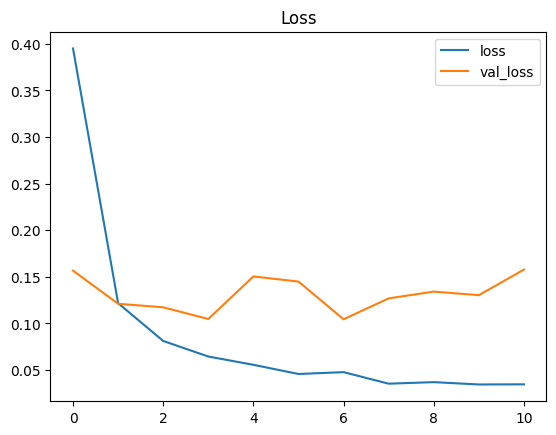

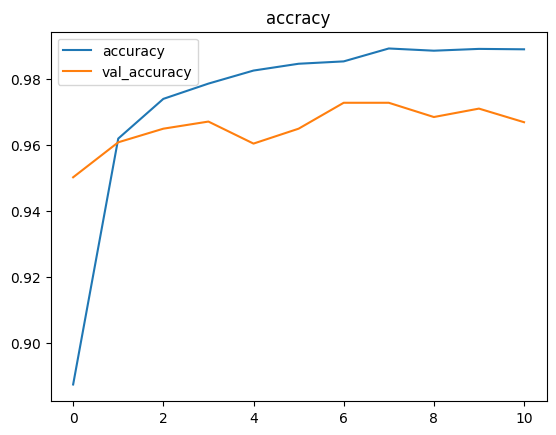

In [42]:
plot_model_trained(history_all)

159/159 ━━━━━━━━━━━━━━━━━━━━ 36s 191ms/step
Accuracy on the test set: 96.95%


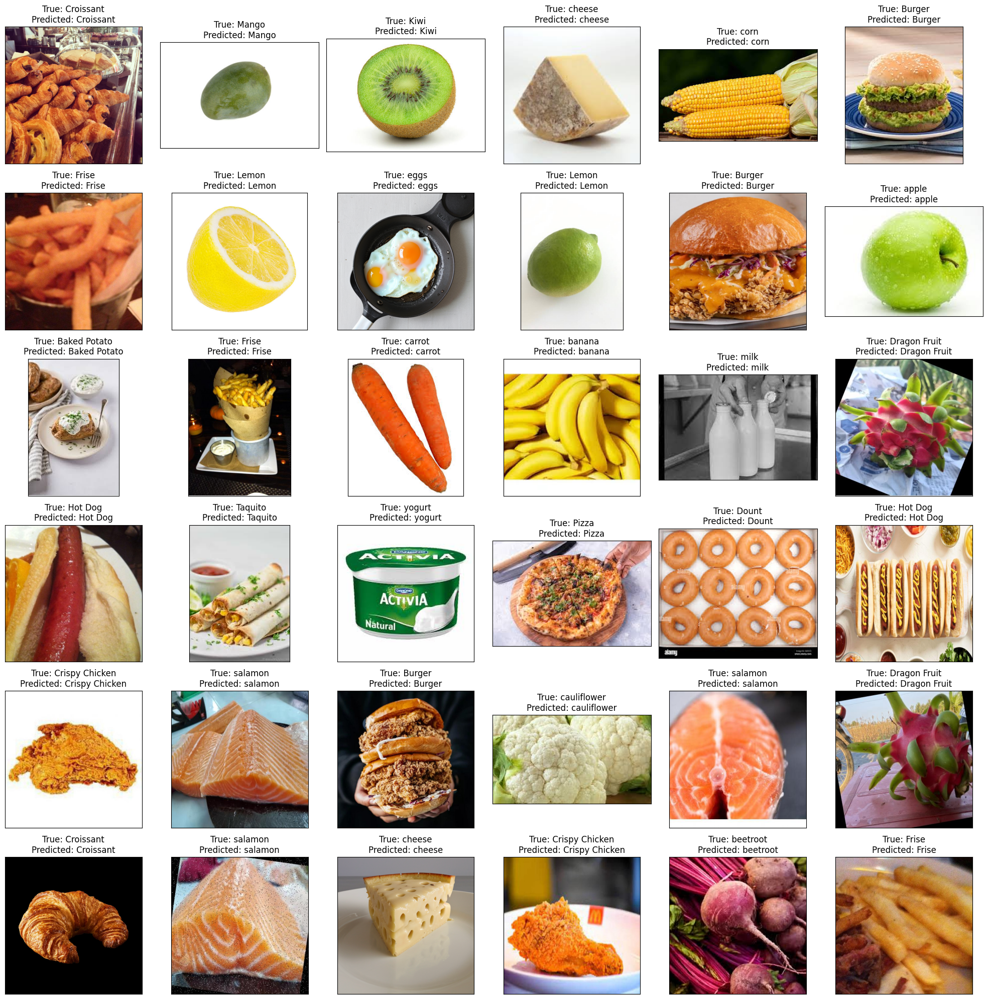

In [41]:
evaluate_and_display(model_all, test_images, train_images, test_df)

In [43]:
model_all.save('NewVersionModelOptimized.keras')

# Try with Unfreez some layers

In [49]:
pretrained_model_unfreeze = tf.keras.applications.EfficientNetB0 (
    input_shape=(224, 224, 3),
    include_top=False,
    weights='imagenet',
    pooling='avg'
)
pretrained_model_unfreeze.trainable = False

In [50]:
for layer_number, layer in enumerate(pretrained_model_unfreeze.layers):
  print(layer_number, layer.name, layer.trainable)

0 input_layer_2 False
1 rescaling_4 False
2 normalization_2 False
3 rescaling_5 False
4 stem_conv_pad False
5 stem_conv False
6 stem_bn False
7 stem_activation False
8 block1a_dwconv False
9 block1a_bn False
10 block1a_activation False
11 block1a_se_squeeze False
12 block1a_se_reshape False
13 block1a_se_reduce False
14 block1a_se_expand False
15 block1a_se_excite False
16 block1a_project_conv False
17 block1a_project_bn False
18 block2a_expand_conv False
19 block2a_expand_bn False
20 block2a_expand_activation False
21 block2a_dwconv_pad False
22 block2a_dwconv False
23 block2a_bn False
24 block2a_activation False
25 block2a_se_squeeze False
26 block2a_se_reshape False
27 block2a_se_reduce False
28 block2a_se_expand False
29 block2a_se_excite False
30 block2a_project_conv False
31 block2a_project_bn False
32 block2b_expand_conv False
33 block2b_expand_bn False
34 block2b_expand_activation False
35 block2b_dwconv False
36 block2b_bn False
37 block2b_activation False
38 block2b_se_squeez

In [51]:
pretrained_model_unfreeze.trainable = True

# Freeze all layers except for the last 10
for layer in pretrained_model_unfreeze.layers[:-5]:
  layer.trainable = False

In [52]:
for layer_number, layer in enumerate(pretrained_model_unfreeze.layers):
  print(layer_number, layer.name, layer.trainable)

0 input_layer_2 False
1 rescaling_4 False
2 normalization_2 False
3 rescaling_5 False
4 stem_conv_pad False
5 stem_conv False
6 stem_bn False
7 stem_activation False
8 block1a_dwconv False
9 block1a_bn False
10 block1a_activation False
11 block1a_se_squeeze False
12 block1a_se_reshape False
13 block1a_se_reduce False
14 block1a_se_expand False
15 block1a_se_excite False
16 block1a_project_conv False
17 block1a_project_bn False
18 block2a_expand_conv False
19 block2a_expand_bn False
20 block2a_expand_activation False
21 block2a_dwconv_pad False
22 block2a_dwconv False
23 block2a_bn False
24 block2a_activation False
25 block2a_se_squeeze False
26 block2a_se_reshape False
27 block2a_se_reduce False
28 block2a_se_expand False
29 block2a_se_excite False
30 block2a_project_conv False
31 block2a_project_bn False
32 block2b_expand_conv False
33 block2b_expand_bn False
34 block2b_expand_activation False
35 block2b_dwconv False
36 block2b_bn False
37 block2b_activation False
38 block2b_se_squeez

In [53]:
inputs = pretrained_model_unfreeze.input

x = tf.keras.layers.Dense(256, activation='relu')(pretrained_model_unfreeze.output)
x = tf.keras.layers.Dense(128, activation='relu')(x)


outputs = tf.keras.layers.Dense(len(train_images.class_indices), activation='softmax')(x)

model_unfreeze = tf.keras.Model(inputs=inputs, outputs=outputs)

model_unfreeze.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

initial_epoch=30

history_unfreeze = model_unfreeze.fit(
    train_images,
    validation_data=val_images,
    batch_size = 32,
    epochs=initial_epoch,
    callbacks=[
        tf.keras.callbacks.EarlyStopping(
            monitor='val_accuracy',
            patience=4,
            restore_best_weights=True
        ),
        tf.keras.callbacks.ModelCheckpoint(
        filepath = 'Unfreez.keras',
        monitor = 'val_accuracy',
        save_best_only = True,
        mode = 'max',
        verbose = 1
        ),
        tf.keras.callbacks.ReduceLROnPlateau(
            monitor='val_loss',
            factor=0.5,
            patience=2,
            verbose=1,
            min_lr=1e-6
        )
    ]
)

Epoch 1/30
741/742 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - accuracy: 0.8257 - loss: 0.6789
Epoch 1: val_accuracy improved from -inf to 0.95024, saving model to Unfreez.keras
742/742 ━━━━━━━━━━━━━━━━━━━━ 134s 154ms/step - accuracy: 0.8260 - loss: 0.6780 - val_accuracy: 0.9502 - val_loss: 0.1706 - learning_rate: 0.0010
Epoch 2/30
741/742 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step - accuracy: 0.9642 - loss: 0.1157
Epoch 2: val_accuracy improved from 0.95024 to 0.97187, saving model to Unfreez.keras
742/742 ━━━━━━━━━━━━━━━━━━━━ 93s 125ms/step - accuracy: 0.9642 - loss: 0.1157 - val_accuracy: 0.9719 - val_loss: 0.0887 - learning_rate: 0.0010
Epoch 3/30
741/742 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step - accuracy: 0.9767 - loss: 0.0790
Epoch 3: val_accuracy improved from 0.97187 to 0.97305, saving model to Unfreez.keras
742/742 ━━━━━━━━━━━━━━━━━━━━ 94s 125ms/step - accuracy: 0.9767 - loss: 0.0790 - val_accuracy: 0.9731 - val_loss: 0.0961 - learning_rate: 0.0010
Epoch 4/30
741/742 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms

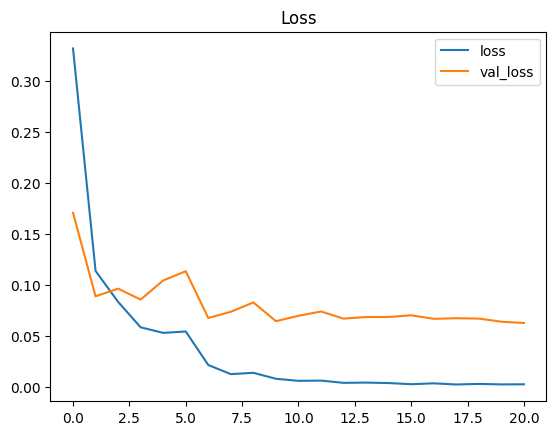

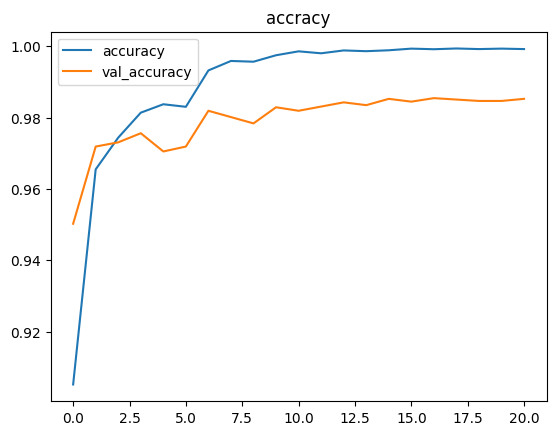

In [54]:
plot_model_trained(history_unfreeze)

In [55]:
test_loss, test_accuracy = model_unfreeze.evaluate(test_images)
print(f"Test Loss: {test_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")

159/159 ━━━━━━━━━━━━━━━━━━━━ 21s 132ms/step - accuracy: 0.9824 - loss: 0.0961
Test Loss: 0.0962
Test Accuracy: 0.9829


159/159 ━━━━━━━━━━━━━━━━━━━━ 28s 139ms/step
Accuracy on the test set: 98.29%


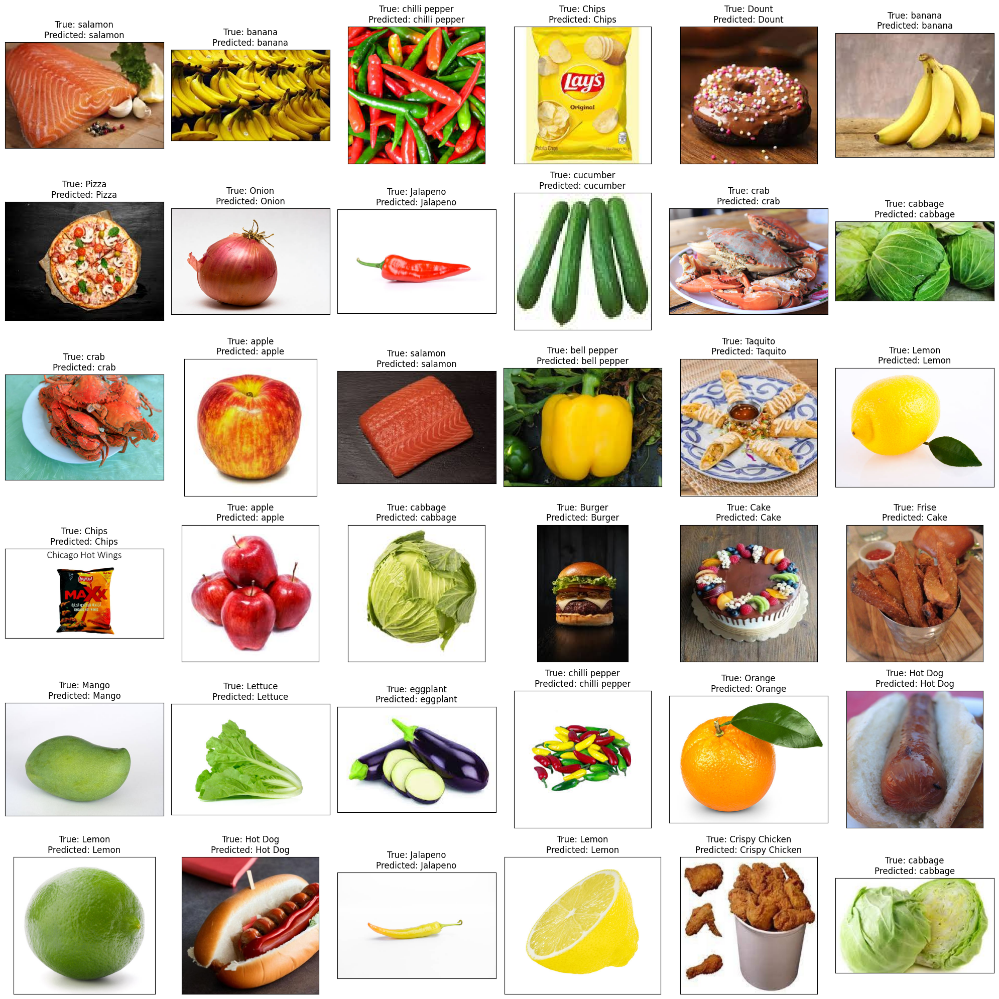

In [56]:
evaluate_and_display(model_unfreeze, test_images, train_images, test_df)

In [86]:
model_unfreeze.save('NewVersionModelOptimized40V2.keras')

# Testing

In [57]:
class_labels=train_images.class_indices
class_labels = {v: k for k, v in class_labels.items()}
class_labels

{0: 'Baked Potato',
 1: 'Burger',
 2: 'Cake',
 3: 'Chips',
 4: 'Crispy Chicken',
 5: 'Croissant',
 6: 'Dount',
 7: 'Dragon Fruit',
 8: 'Frise',
 9: 'Hot Dog',
 10: 'Jalapeno',
 11: 'Kiwi',
 12: 'Lemon',
 13: 'Lettuce',
 14: 'Mango',
 15: 'Onion',
 16: 'Orange',
 17: 'Pizza',
 18: 'Taquito',
 19: 'apple',
 20: 'banana',
 21: 'beetroot',
 22: 'bell pepper',
 23: 'bread',
 24: 'cabbage',
 25: 'carrot',
 26: 'cauliflower',
 27: 'cheese',
 28: 'chilli pepper',
 29: 'corn',
 30: 'crab',
 31: 'cucumber',
 32: 'eggplant',
 33: 'eggs',
 34: 'garlic',
 35: 'ginger',
 36: 'grapes',
 37: 'milk',
 38: 'salamon',
 39: 'yogurt'}

In [104]:
def predict_and_plot_image(model, image_path, class_names):
    """
    Loads an image from a file path, preprocesses it, makes a prediction,
    and displays the image along with the predicted class.
    
    Parameters:
    - model: Trained TensorFlow model to use for predictions.
    - image_path: File path of the image to load and predict.
    - class_names: List of class names corresponding to the model's output classes.
    """
    # Load and preprocess the image
    img = load_and_prep_image(image_path, img_shape=224)  # Resize and preprocess the image
    img = tf.expand_dims(img, axis=0)  # Add batch dimension
    # Make a prediction
    pred = model.predict(img)
    pred_class_index = np.argmax(pred, axis=1)[0]  # Get index of highest probability
    pred_class_name = class_names[pred_class_index]  # Convert index to class name

    # Display the image with the prediction
    plt.imshow(plt.imread(image_path))
    plt.title(f"Predicted: {pred_class_name}")
    plt.axis("off")
    plt.show()

In [84]:
!wget https://www.moulinex.com.eg/medias/?context=bWFzdGVyfHJvb3R8MTQzNTExfGFwcGxpY2F0aW9uL29jdGV0LXN0cmVhbXxhRFl5TDJneE9TOHhNekV4TVRjM01UVXlPVEkwTmk1aWFXNHw3NTkwMmNjYmFhZTUwZjYwNzk0ZmQyNjVmMjEzYjZiNGI3YzU1NGI3ZGNjYjM3YjYxZGY5Y2Y0ZTdjZmZkZmNj

--2025-01-30 00:25:28--  https://www.moulinex.com.eg/medias/?context=bWFzdGVyfHJvb3R8MTQzNTExfGFwcGxpY2F0aW9uL29jdGV0LXN0cmVhbXxhRFl5TDJneE9TOHhNekV4TVRjM01UVXlPVEkwTmk1aWFXNHw3NTkwMmNjYmFhZTUwZjYwNzk0ZmQyNjVmMjEzYjZiNGI3YzU1NGI3ZGNjYjM3YjYxZGY5Y2Y0ZTdjZmZkZmNj
Resolving www.moulinex.com.eg (www.moulinex.com.eg)... 172.64.145.41, 104.18.42.215, 2606:4700:4400::ac40:9129, ...
Connecting to www.moulinex.com.eg (www.moulinex.com.eg)|172.64.145.41|:443... connected.
HTTP request sent, awaiting response... 200 
Length: 143511 (140K) [application/octet-stream]
Saving to: ‘index.html?context=bWFzdGVyfHJvb3R8MTQzNTExfGFwcGxpY2F0aW9uL29jdGV0LXN0cmVhbXxhRFl5TDJneE9TOHhNekV4TVRjM01UVXlPVEkwTmk1aWFXNHw3NTkwMmNjYmFhZTUwZjYwNzk0ZmQyNjVmMjEzYjZiNGI3YzU1NGI3ZGNjYjM3YjYxZGY5Y2Y0ZTdjZmZkZmNj’

index.html?context= 100%[===================>] 140.15K  --.-KB/s    in 0.08s   

2025-01-30 00:25:29 (1.79 MB/s) - ‘index.html?context=bWFzdGVyfHJvb3R8MTQzNTExfGFwcGxpY2F0aW9uL29jdGV0LXN0cmVhbXxhRFl5TDJneE9TOHhNek

In [92]:
!wget https://mediaproxy.snopes.com/width/1200/https://media.snopes.com/2022/11/1440px-pizza_funghi_mit_pizzahalter.jpeg

--2025-01-30 00:37:40--  https://mediaproxy.snopes.com/width/1200/https://media.snopes.com/2022/11/1440px-pizza_funghi_mit_pizzahalter.jpeg
Resolving mediaproxy.snopes.com (mediaproxy.snopes.com)... 18.238.136.126, 18.238.136.88, 18.238.136.21, ...
Connecting to mediaproxy.snopes.com (mediaproxy.snopes.com)|18.238.136.126|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 239464 (234K) [image/jpeg]
Saving to: ‘1440px-pizza_funghi_mit_pizzahalter.jpeg’

1440px-pizza_funghi 100%[===================>] 233.85K  1.18MB/s    in 0.2s    

2025-01-30 00:37:41 (1.18 MB/s) - ‘1440px-pizza_funghi_mit_pizzahalter.jpeg’ saved [239464/239464]



In [102]:
!wget https://img.freepik.com/free-photo/green-chili-peppers_2829-14074.jpg

--2025-01-30 00:40:41--  https://img.freepik.com/free-photo/green-chili-peppers_2829-14074.jpg
Resolving img.freepik.com (img.freepik.com)... 23.46.30.156, 23.46.30.146, 2600:1407:7800::687b:9f48, ...
Connecting to img.freepik.com (img.freepik.com)|23.46.30.156|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 89341 (87K) [image/jpeg]
Saving to: ‘green-chili-peppers_2829-14074.jpg’

green-chili-peppers 100%[===================>]  87.25K   303KB/s    in 0.3s    

2025-01-30 00:40:42 (303 KB/s) - ‘green-chili-peppers_2829-14074.jpg’ saved [89341/89341]



In [108]:
mode=tf.keras.models.load_model('NewVersionModelOptimized40V2.keras')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


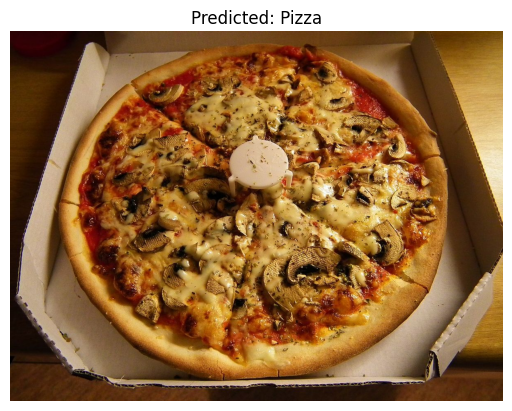

In [111]:
predict_and_plot_image(mode,'1440px-pizza_funghi_mit_pizzahalter.jpeg',class_labels)

In [77]:
images_testing_chrome=['jalapeno.jpg?v=1669750479',
'6210_Kiwi.jpg',
'organic-lemon.jpg',
'Buy-Lettuce-Online-in-Nepal-.png',
'1920_stock-photo-fresh-mango-129537233.jpg?10000',
'geR3AQ0chf.jpg?v=1623063703',
'french-style-country-loaf.jpg?itok=LVIWYfCO',
'AdobeStock_130281036-5376x4214-b0eeb384-e4a9-4b9b-bc90-cdbbf4d24b40_2472x.jpg?v=1684341151',
'types-of-crab-hero.jpg',
'perfect-fried-eggs.jpg',
'1_Milka.jpg',
'MicrosoftTeams-image-5-2500x1250.jpg',
'nestle-0-fat-strawberry-125g.png',
'2466-1.jpg',
'four-heads-of-garlic-sitting-on-a-wooden-board-1400.jpg',
'Cucumber-Tendergreen.jpg?v=1678114273',
'19394247-52AC-4B8A-84AA-70694155FEA8-scaled.jpeg',
'ginger-plant-compressed.jpg',
'JAPAN-AGRICULTURE-FOOD-GRAPE-020814.jpg?VersionId=lhRiOeL_zJvTm41TdxMML2Qr2sxxI4__',
'Poivre-noir-vs.-Piment-de-Cayenne.jpg?v=1626081003',
'Cook-Burgers-on-the-Stove-FT24_277152_EC_0904_1-vert-social.jpg',
'/kaggle/input/700-8classes/Data/Taquito/Taquito-Train (967).jpeg',
'Apples-184940975-770x533-1_jpg',
'charming-photo-ripe-banana-lying-600nw-2475573467.jpg',
'raw-beetroot-on-a-wooden-surface.jpg',
'1-40.jpg',
'Napa-cabbage.jpg',
'Carrot_Extract.png?v=1653976604',
'330px-Hot_dog_with_mustard.png',
'oven-baked-potatoes-7.jpg',
'png-clipart-mcdonald-s-french-fries-hamburger-mcdonald-s-big-mac-mcdonald-s-quarter-pounder-chips-food-vegetables.png']

def pred_testing_images(model, class_labels, images_testing_chrome):
    for image_path in images_testing_chrome:
        predict_and_plot_image(model, image_path, class_labels)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


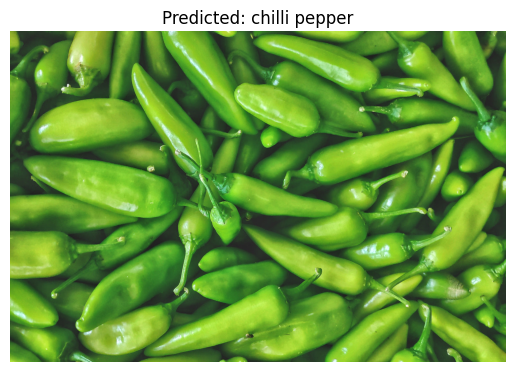

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


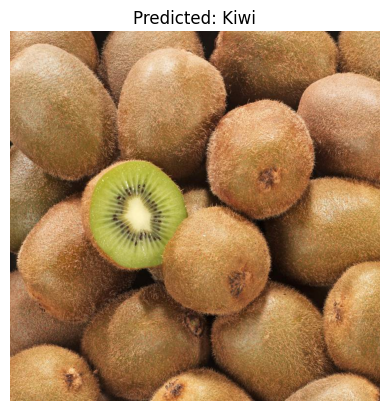

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


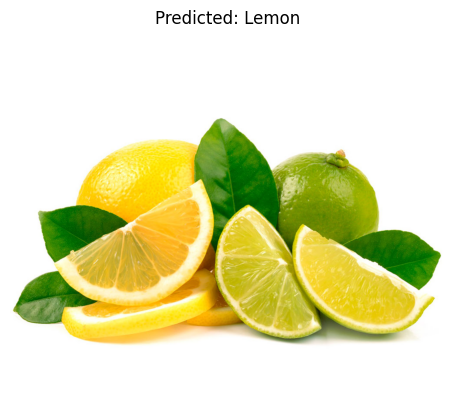

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


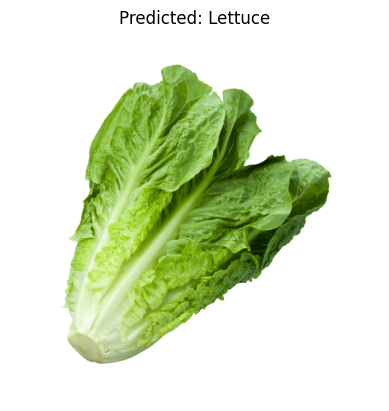

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


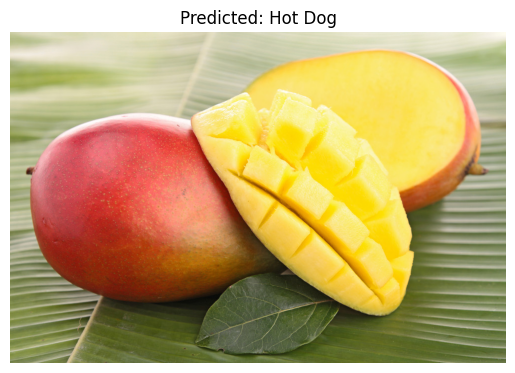

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


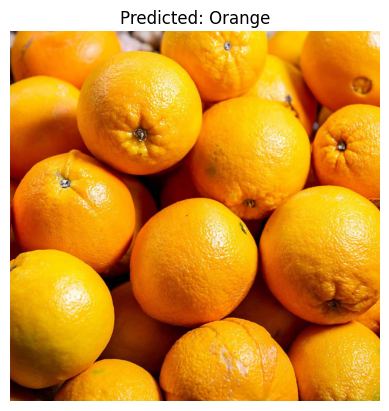

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


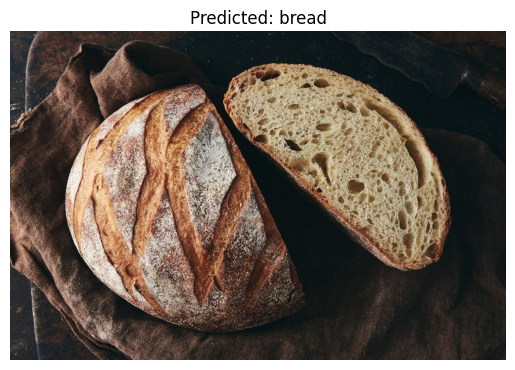

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


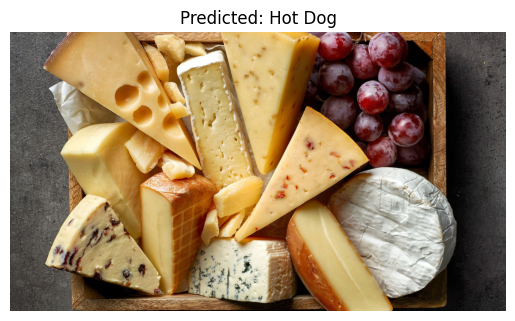

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


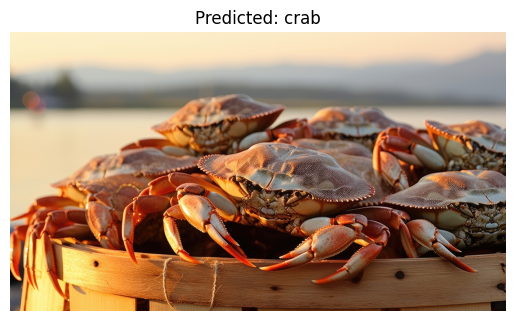

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


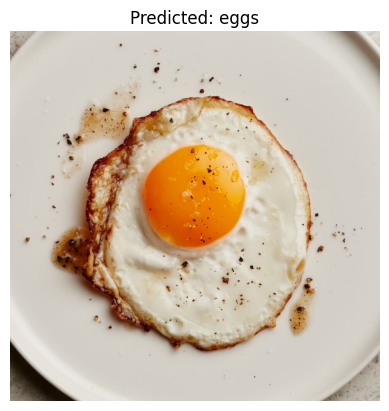

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


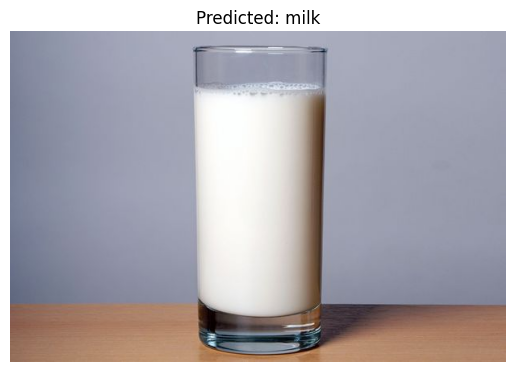

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


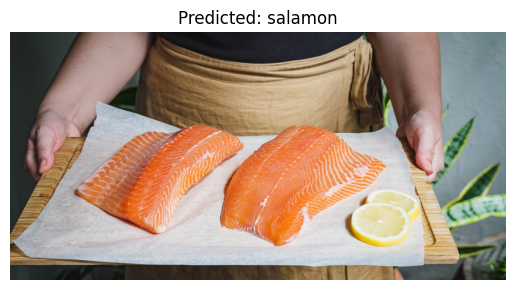

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


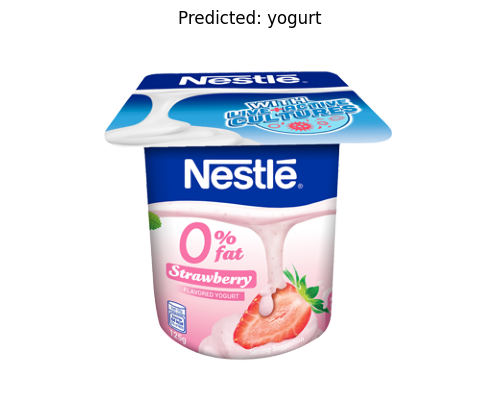

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


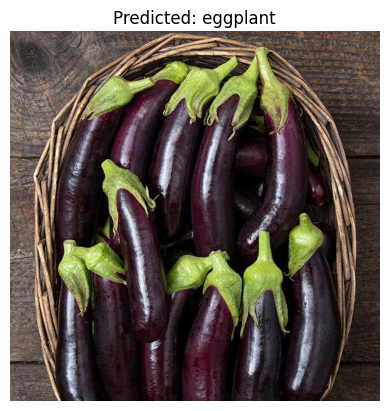

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


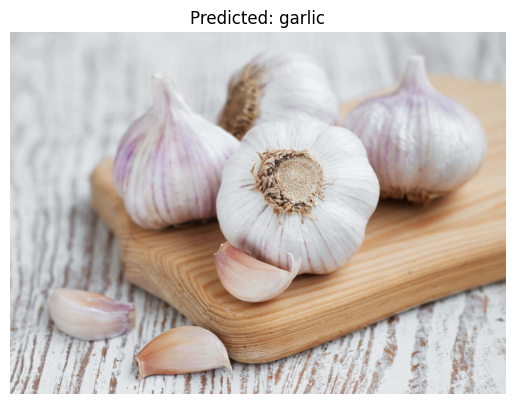

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


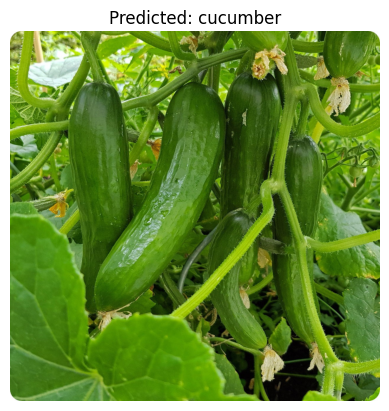

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


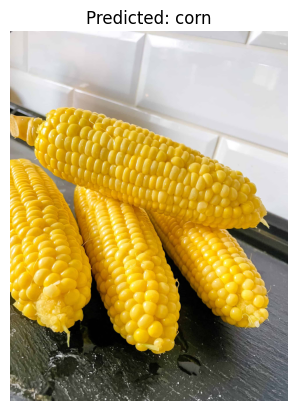

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


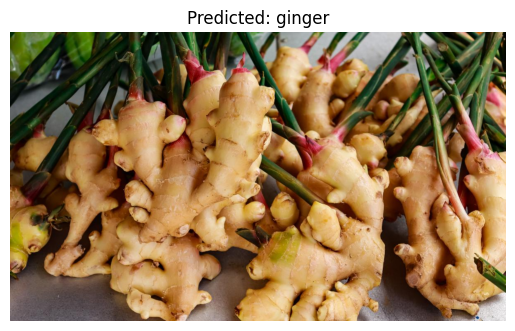

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


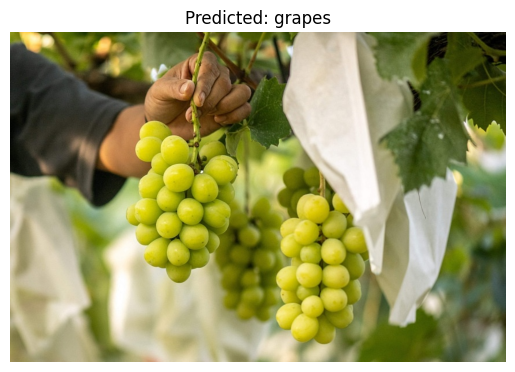

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


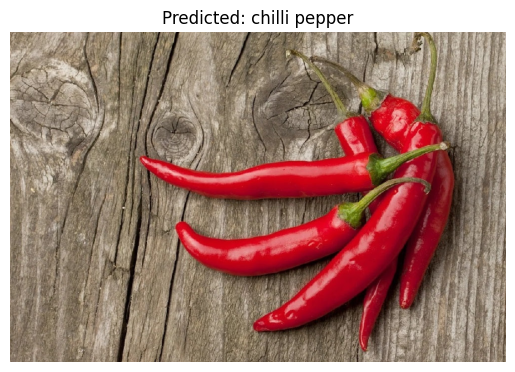

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


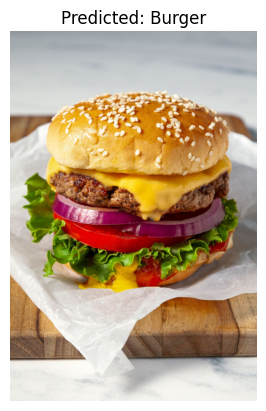

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


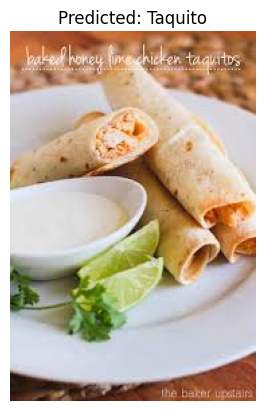

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


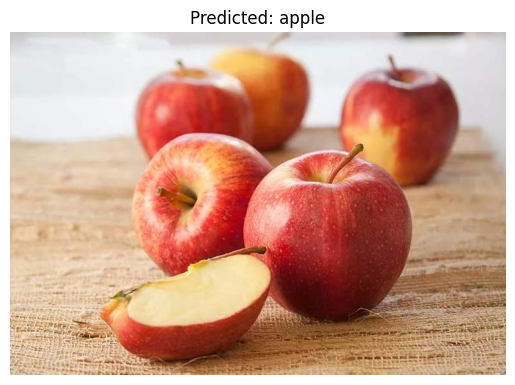

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


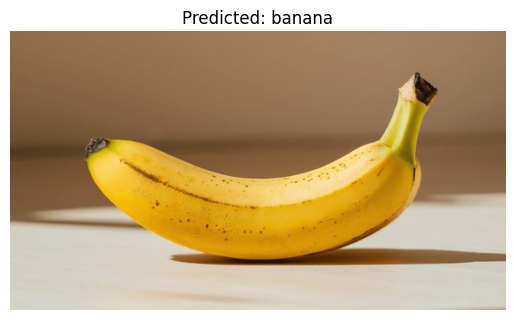

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


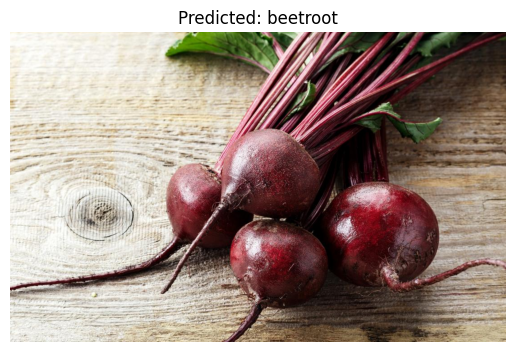

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


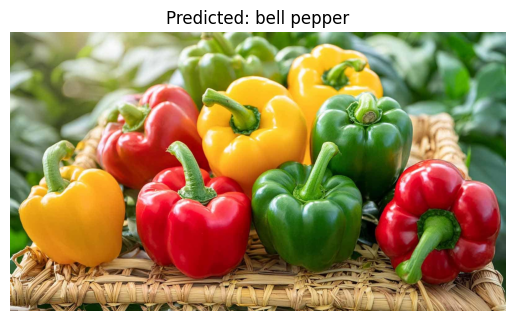

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


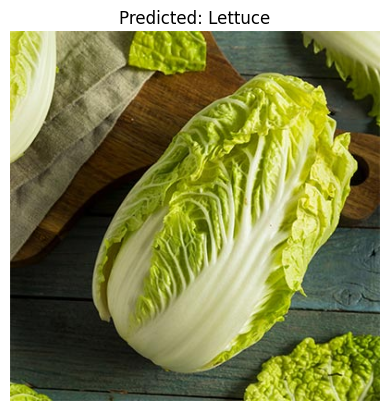

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


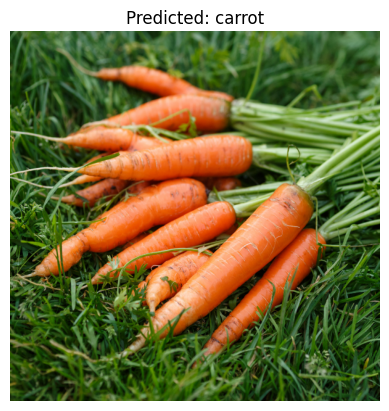

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


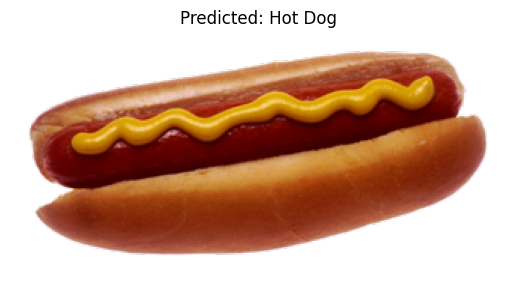

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


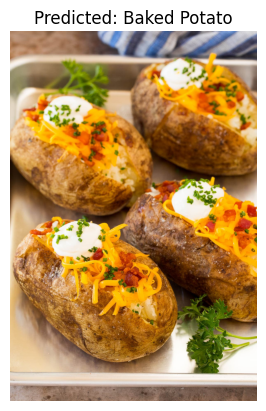

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


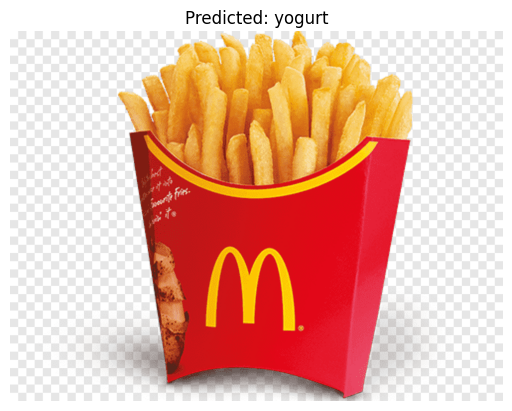

In [97]:
pred_testing_images(model_all, class_labels, images_testing_chrome)

In [98]:
import os
import requests
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from io import BytesIO

def download_image_from_url(url, filename):
    # Ensure the image is downloaded
    if not os.path.exists(filename):
        response = requests.get(url)
        img = Image.open(BytesIO(response.content))
        img.save(filename)
    return filename

def load_and_prep_image(filename, img_shape=224):
    # Read and preprocess the image
    img = tf.io.read_file(filename)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.resize(img, size=[img_shape, img_shape])
    return img

def predict_and_plot_image(model, image_url, class_names, index):
    """
    Downloads an image from a URL, preprocesses it, makes a prediction,
    and displays the image along with the predicted class.
    
    Parameters:
    - model: Trained TensorFlow model to use for predictions.
    - image_url: URL of the image to download and predict.
    - class_names: List of class names corresponding to the model's output classes.
    - index: Index of the image to use for generating a unique filename.
    """
    print(f"Processing image: {image_url}")  # Debugging line to check which image is being processed
    
    # Generate a unique filename for each image based on the index
    img_filename = f"downloaded_image_{index}.png"  # Name for saving the image
    
    # Download and load the image
    download_image_from_url(image_url, img_filename)
    
    # Load and preprocess the image
    img = load_and_prep_image(img_filename, img_shape=224)
    img = tf.expand_dims(img, axis=0)  # Add batch dimension
    
    # Make a prediction
    pred = model.predict(img)
    pred_class_index = np.argmax(pred, axis=1)[0]  # Get index of highest probability
    pred_class_name = class_names[pred_class_index]  # Convert index to class name

    # Display the image with the prediction
    plt.clf()  # Clear the previous plot
    plt.imshow(plt.imread(img_filename))
    plt.title(f"Predicted: {pred_class_name}")
    plt.axis("off")
    plt.show()

# Example usage for multiple images
image_urls = [
    'https://organiclivestockandcrops.org/wp-content/uploads/2018/06/organic-lemon.jpg',
    '!wget https://cdn.shopify.com/s/files/1/2182/2603/files/jalapeno.jpg?v=1669750479',
    'https://froneri.ph/wp-content/uploads/2022/10/nestle-0-fat-strawberry-125g.png',
    'https://ellegourmet.ca/wp-content/uploads/2023/04/perfect-fried-eggs.jpg',
    'https://raw.githubusercontent.com/mo-basett/testimage/8326947cc59e3560dabb35f4ceb25c4b429dfa9f/IMG-20241108-WA0146.png',
    'https://raw.githubusercontent.com/mo-basett/testimage/8326947cc59e3560dabb35f4ceb25c4b429dfa9f/IMG-20241108-WA0147.png',
    'https://raw.githubusercontent.com/mo-basett/testimage/8326947cc59e3560dabb35f4ceb25c4b429dfa9f/IMG-20241108-WA0148.png',
    'https://raw.githubusercontent.com/mo-basett/testimage/8326947cc59e3560dabb35f4ceb25c4b429dfa9f/IMG-20241108-WA0149.png',
    'https://raw.githubusercontent.com/mo-basett/testimage/8326947cc59e3560dabb35f4ceb25c4b429dfa9f/IMG-20241108-WA0150.png',
    'https://raw.githubusercontent.com/mo-basett/testimage/8326947cc59e3560dabb35f4ceb25c4b429dfa9f/IMG-20241108-WA0151.png',
    'https://raw.githubusercontent.com/mo-basett/testimage/8326947cc59e3560dabb35f4ceb25c4b429dfa9f/IMG-20241108-WA0153.png',
    'https://raw.githubusercontent.com/mo-basett/testimage/8326947cc59e3560dabb35f4ceb25c4b429dfa9f/IMG-20241108-WA0154.png'
]

Processing image: https://organiclivestockandcrops.org/wp-content/uploads/2018/06/organic-lemon.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


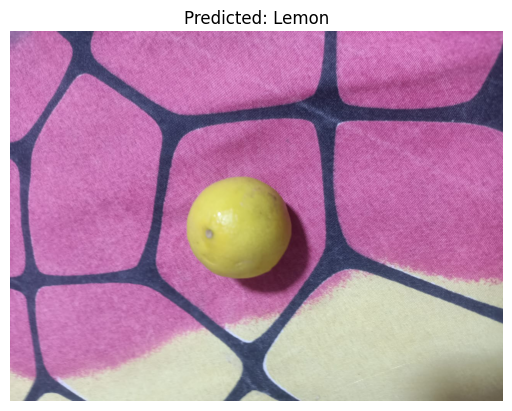

Processing image: !wget https://cdn.shopify.com/s/files/1/2182/2603/files/jalapeno.jpg?v=1669750479
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


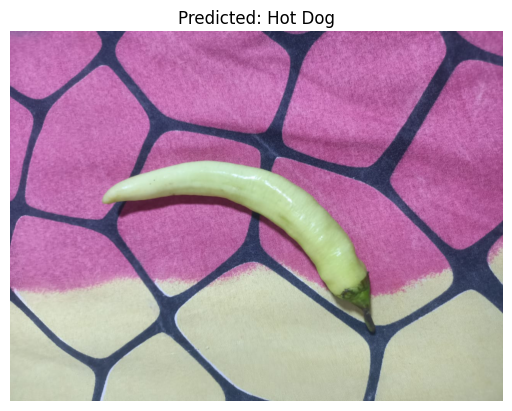

Processing image: https://froneri.ph/wp-content/uploads/2022/10/nestle-0-fat-strawberry-125g.png
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


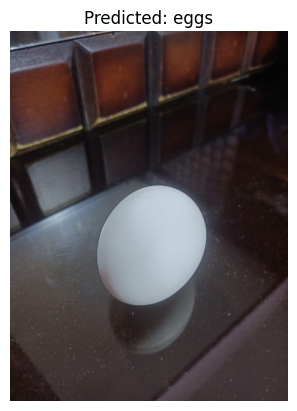

Processing image: https://ellegourmet.ca/wp-content/uploads/2023/04/perfect-fried-eggs.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


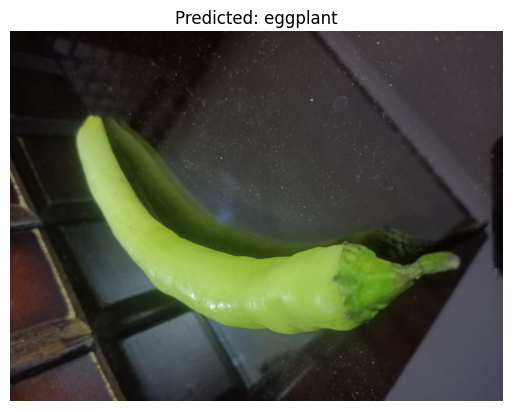

Processing image: https://raw.githubusercontent.com/mo-basett/testimage/8326947cc59e3560dabb35f4ceb25c4b429dfa9f/IMG-20241108-WA0146.png
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


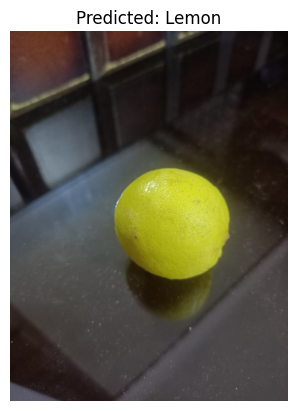

Processing image: https://raw.githubusercontent.com/mo-basett/testimage/8326947cc59e3560dabb35f4ceb25c4b429dfa9f/IMG-20241108-WA0147.png
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


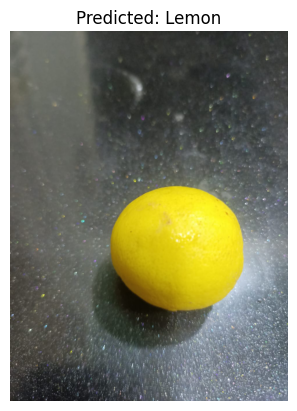

Processing image: https://raw.githubusercontent.com/mo-basett/testimage/8326947cc59e3560dabb35f4ceb25c4b429dfa9f/IMG-20241108-WA0148.png
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


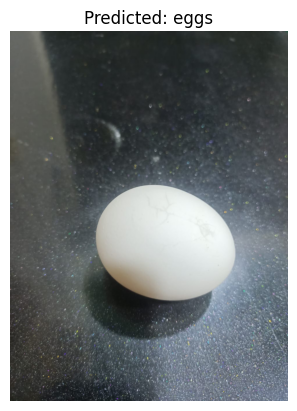

Processing image: https://raw.githubusercontent.com/mo-basett/testimage/8326947cc59e3560dabb35f4ceb25c4b429dfa9f/IMG-20241108-WA0149.png
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


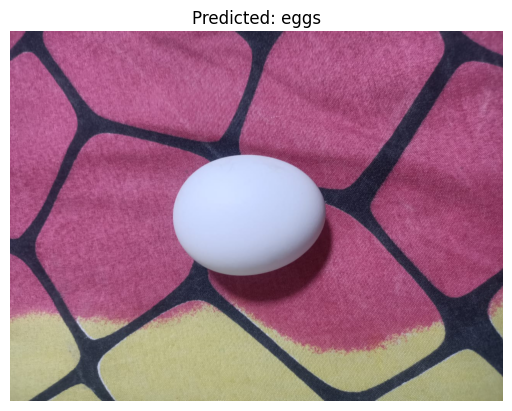

Processing image: https://raw.githubusercontent.com/mo-basett/testimage/8326947cc59e3560dabb35f4ceb25c4b429dfa9f/IMG-20241108-WA0150.png
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


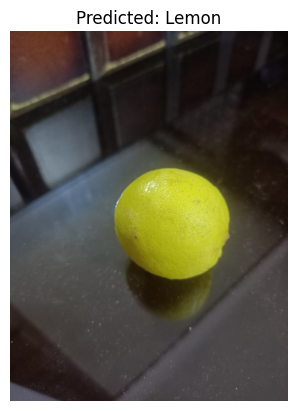

Processing image: https://raw.githubusercontent.com/mo-basett/testimage/8326947cc59e3560dabb35f4ceb25c4b429dfa9f/IMG-20241108-WA0151.png
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


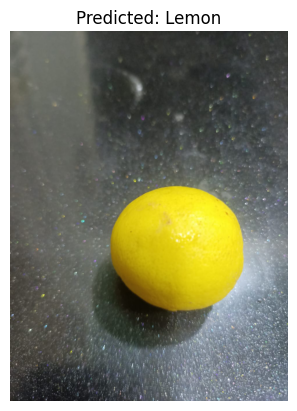

Processing image: https://raw.githubusercontent.com/mo-basett/testimage/8326947cc59e3560dabb35f4ceb25c4b429dfa9f/IMG-20241108-WA0153.png
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


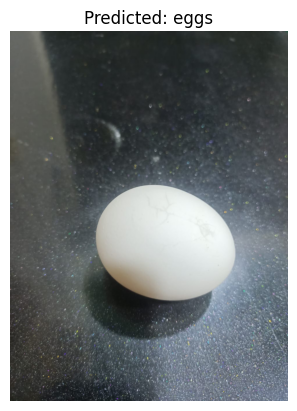

Processing image: https://raw.githubusercontent.com/mo-basett/testimage/8326947cc59e3560dabb35f4ceb25c4b429dfa9f/IMG-20241108-WA0154.png
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


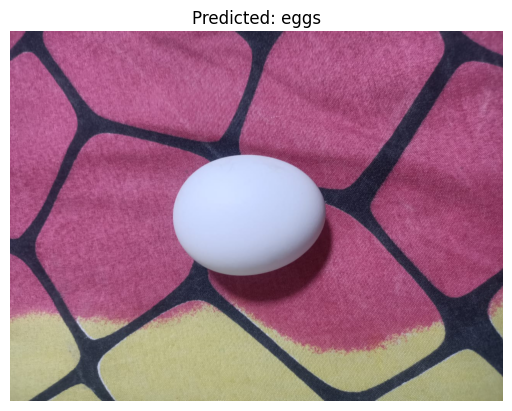

In [99]:
for index, image_url in enumerate(image_urls):
    predict_and_plot_image(model_unfreeze, image_url, class_labels, index)

In [63]:
!wget https://iod.keplrstatic.com/api/ar_1,c_crop,g_north/c_fill,dpr_auto,f_auto,q_70,w_750/mon_marche/6210_Kiwi.jpg
!wget https://onlinetarkaripasal.com/wp-content/uploads/2021/05/Buy-Lettuce-Online-in-Nepal-.png
!wget https://organiclivestockandcrops.org/wp-content/uploads/2018/06/organic-lemon.jpg
!wget https://cdn.shopify.com/s/files/1/2182/2603/files/jalapeno.jpg?v=1669750479
!wget https://ellegourmet.ca/wp-content/uploads/2023/04/perfect-fried-eggs.jpg
!wget https://froneri.ph/wp-content/uploads/2022/10/nestle-0-fat-strawberry-125g.png
!wget https://www.onceuponachef.com/images/2024/04/Fried-Egg-Hero-3-1200x900.jpg
!wget https://shop.adelaidecentralmarket.com.au/cdn/shop/products/geR3AQ0chf.jpg?v=1623063703
!wget https://www.bigbasket.com/media/uploads/p/xxl/40075537_6-fresho-onion.jpg
!wget https://content.presspage.com/uploads/1460/69fbd9b4-d9fb-4591-8ede-0deb9c917a13/1920_stock-photo-fresh-mango-129537233.jpg?10000
!wget https://www.stylecraze.com/wp-content/uploads/2013/07/Benefits-Of-Lettuce-For-Skin-Hair-And-Health.jpg
!wget https://cdn.britannica.com/84/188484-050-F27B0049/lemons-tree.jpg
!wget https://media.post.rvohealth.io/wp-content/uploads/2022/02/female-cutting-kiwi-732-549-feature-thumb.jpg
!wget https://shop.westlandpeppers.com/wp-content/uploads/2013/08/Jalapeno-green_Westlandpeppers-1-scaled.jpg
!wget https://littlespoonfarm.com/wp-content/uploads/2023/01/homemade-raw-yogurt-recipe.jpg
!wget https://asc-aqua.org/wp-content/uploads/2023/04/MicrosoftTeams-image-5-2500x1250.jpg
!wget https://whitehousecomms.com/wp-content/uploads/2021/02/1_Milka.jpg
!wget https://tastefullygrace.com/wp-content/uploads/2022/12/How-to-Make-Scrambled-Eggs-2-scaled.jpg
!wget https://images.contentstack.io/v3/assets/bltcedd8dbd5891265b/bltb17ba89c72cd3623/664cbe1b0e01e67a02105171/types-of-crab-hero.jpg
!wget https://www.kingarthurbaking.com/sites/default/files/styles/featured_image/public/2020-05/french-style-country-loaf.jpg?itok=LVIWYfCO
!wget https://cabotcreamery.com/cdn/shop/articles/AdobeStock_130281036-5376x4214-b0eeb384-e4a9-4b9b-bc90-cdbbf4d24b40_2472x.jpg?v=1684341151
!wget https://www.incredibleseeds.ca/cdn/shop/products/Cucumber-Tendergreen.jpg?v=1678114273
!wget https://www.escoffieronline.com/wp-content/uploads/2013/04/four-heads-of-garlic-sitting-on-a-wooden-board-1400.jpg
!wget https://aqueenathekitchen.com/wp-content/uploads/2022/06/19394247-52AC-4B8A-84AA-70694155FEA8-scaled.jpeg
!wget https://www.highmowingseeds.com/media/catalog/product/cache/95cbc1bb565f689da055dd93b41e1c28/2/4/2466-1.jpg
!wget https://housing.com/news/wp-content/uploads/2022/11/ginger-plant-compressed.jpg
!wget https://static1.straitstimes.com.sg/s3fs-public/styles/large30x20/public/articles/2024/10/29/JAPAN-AGRICULTURE-FOOD-GRAPE-020814.jpg?VersionId=lhRiOeL_zJvTm41TdxMML2Qr2sxxI4__
!wget https://urbancuisine.io/cdn/shop/articles/Poivre-noir-vs.-Piment-de-Cayenne.jpg?v=1626081003
!wget https://cdn.shopify.com/s/files/1/0058/7779/2832/files/Carrot_Extract.png?v=1653976604
!wget https://www.koppert.eg/content/_processed_/f/3/csm_Cauliflower_b34e6786a9.jpg
!wget https://lacrosseallergy.com/wp-content/uploads/2024/05/Napa-cabbage.jpg
!wget https://images.healthshots.com/healthshots/en/uploads/2024/07/24112903/1-40.jpg
!wget https://post.medicalnewstoday.com/wp-content/uploads/sites/3/2019/11/raw-beetroot-on-a-wooden-surface.jpg
!wget https://www.shutterstock.com/image-photo/charming-photo-ripe-banana-lying-600nw-2475573467.jpg
!wget https://assets.clevelandclinic.org/transform/cd71f4bd-81d4-45d8-a450-74df78e4477a/Apples-184940975-770x533-1_jpg
!wget https://upload.wikimedia.org/wikipedia/commons/thumb/b/b1/Hot_dog_with_mustard.png/330px-Hot_dog_with_mustard.png
!wget https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcT3RhAkXrDXaU8_tVgEFovixM6eCSLN3CJl5Q&s
!wget https://www.dinneratthezoo.com/wp-content/uploads/2021/04/oven-baked-potatoes-7.jpg
!wget https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcTGQrkf--VGr8QoFoa5pI1AtOEC7ac8M0RaaA&s
!wget https://e7.pngegg.com/pngimages/813/939/png-clipart-mcdonald-s-french-fries-hamburger-mcdonald-s-big-mac-mcdonald-s-quarter-pounder-chips-food-vegetables.png
!wget https://www.tasteofhome.com/wp-content/uploads/2024/09/Cook-Burgers-on-the-Stove-FT24_277152_EC_0904_1-vert-social.jpg

--2025-01-30 00:18:33--  https://iod.keplrstatic.com/api/ar_1,c_crop,g_north/c_fill,dpr_auto,f_auto,q_70,w_750/mon_marche/6210_Kiwi.jpg
Resolving iod.keplrstatic.com (iod.keplrstatic.com)... 34.107.228.161
Connecting to iod.keplrstatic.com (iod.keplrstatic.com)|34.107.228.161|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 111723 (109K) [image/jpeg]
Saving to: ‘6210_Kiwi.jpg’

6210_Kiwi.jpg       100%[===================>] 109.10K  --.-KB/s    in 0.002s  

2025-01-30 00:18:33 (58.4 MB/s) - ‘6210_Kiwi.jpg’ saved [111723/111723]

--2025-01-30 00:18:34--  https://onlinetarkaripasal.com/wp-content/uploads/2021/05/Buy-Lettuce-Online-in-Nepal-.png
Resolving onlinetarkaripasal.com (onlinetarkaripasal.com)... 136.243.112.224
Connecting to onlinetarkaripasal.com (onlinetarkaripasal.com)|136.243.112.224|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 177931 (174K) [image/png]
Saving to: ‘Buy-Lettuce-Online-in-Nepal-.png’

Buy-Lettuce-Online- 10